(fourier-animations)=
# Fourier transforms: animations

## Introduction 🎍




:::{seealso}

- [Video by 3Blue1Brown](https://www.youtube.com/watch?v=-qgreAUpPwM)
- [Jezzamon's Interactive Fourier Vizualization](https://www.jezzamon.com/fourier/)

:::

## Objectives 🎯
1. Create a (complex-valued) signal
2. Compute its Fourier spectrum
3. Vizualize the signal and its spectrum in 2D space
4. Repeat 1-3 for different signals

## Example 1. Positive harmonics

Let $s(t)$ be a complex-valued signal (a sequence of complex numbers).

A complex signal consists of two (independent) parts: real and imaginary. $s(t) = \mathcal {Re}(s(t)) + i\mathcal {Im}(s(t))$ .

$ x = 4\cos(t) - 2\cos(2t) - \cos(4t) $

$ y = 4\sin(t) - 2\sin(2t) - \sin(4t) $

$ s = x + i y $

In [1]:
%matplotlib inline
import matplotlib.pyplot as plt
plt.show()

In [2]:
import matplotlib as mpl
import numpy as np

plt.rcParams.update({'lines.linewidth': 2.0, 'figure.figsize': [8.0, 5.0],
                     'axes.grid' : True, 'grid.linestyle': ":", 'grid.alpha': 0.7, 'lines.markersize': 5})

COLOR_ax = [0.15,0.15,0.15]
mpl.rcParams['text.color'] = COLOR_ax
mpl.rcParams['axes.labelcolor'] = COLOR_ax
mpl.rcParams['xtick.color'] = COLOR_ax
mpl.rcParams['ytick.color'] = COLOR_ax

colorlist_Iceland = np.array([[5, 100, 113], [253, 170, 0], [80, 63, 88], [134, 172, 25], [76, 166, 193], [157, 110, 51], [43, 63, 85]])/255.0
# colorlist_Iceland = np.array([[50, 70, 110], [150, 192, 25], [157, 110, 51], [5, 100, 113], [80, 63, 88], [76, 166, 193], [253, 170, 0]])/255.0
colorlist_Iceland = np.array([[50, 70, 110], [203, 150, 0], [157, 110, 51], [134, 172, 25], [76, 166, 193], [157, 110, 51], [43, 63, 85]])/255.0

colorlist_Iceland = ['#377eb8', '#ff7f00', '#4daf4a', '#984ea3']
colorlist_Iceland = ['#32466e', '#FFA024', '#96c019', '#bb5566', '#44aa99', '#88ccee', '#ffcccc']

mpl.rcParams['axes.prop_cycle'] = mpl.cycler(color = colorlist_Iceland) 

SMALL_SIZE = 14
MEDIUM_SIZE = 16
BIGGER_SIZE = 20

plt.rc('font', size=MEDIUM_SIZE)          # controls default text sizes
plt.rc('axes', titlesize=MEDIUM_SIZE)     # fontsize of the axes title
plt.rc('axes', labelsize=SMALL_SIZE)    # fontsize of the x and y labels
plt.rc('xtick', labelsize=MEDIUM_SIZE)    # fontsize of the tick labels
plt.rc('ytick', labelsize=MEDIUM_SIZE)    # fontsize of the tick labels
plt.rc('legend', fontsize=SMALL_SIZE)    # legend fontsize
plt.rc('figure', titlesize=BIGGER_SIZE)  # fontsize of the figure title


In [3]:
import numpy as np
from numpy import sin, cos, pi, abs, angle
import matplotlib.pyplot as plt

In [4]:
dt = pi/31
t = np.arange(0, 2*pi, dt)

x = 4*cos(t) - 2*cos(2*t) - cos(4*t) # real part
y = 4*sin(t) - 2*sin(2*t) - sin(4*t) # imaginary part

signal = x + 1j * y

Of course we can always plot two graphs, $\mathcal {Re}(t)$ and $\mathcal {Im}(t)$, independently

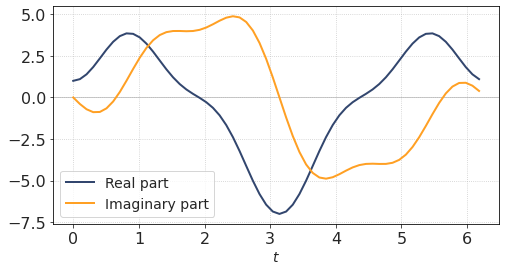

In [5]:
plt.figure(figsize = (8, 4))

plt.plot(t, np.real(signal), label = 'Real part')
plt.plot(t, np.imag(signal), label = 'Imaginary part')

plt.legend()
plt.xlabel('$t$')
plt.axhline(0, lw = 1, c=[0.8,0.8,0.8],zorder = 0)
plt.show()

A common way to plot a complex signal is to plot a 2D curve on a complex plane, where real part is plotted along horizontal axis and imaginary part is plotted along vertical axis.

Thus, the signal $s(t)$ will be represented by a sequence of points on a Cartesian plane. These points (hopefully) will form a line. 

Since our signal is a trigonometric function, the lines are smooth and even beautiful.

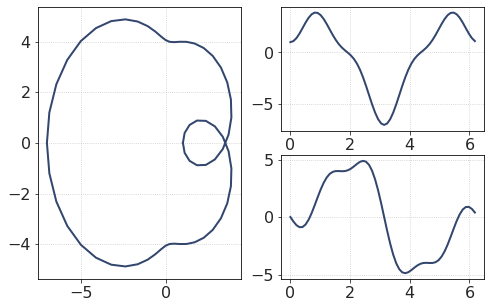

In [6]:
ax1 = plt.subplot(1,2,1)
ax2 = plt.subplot(2,2,2)
ax3 = plt.subplot(2,2,4)

ax1.plot(np.append(x, x[0]),np.append(y,y[0]))
ax2.plot(t, x)
ax3.plot(t, y)

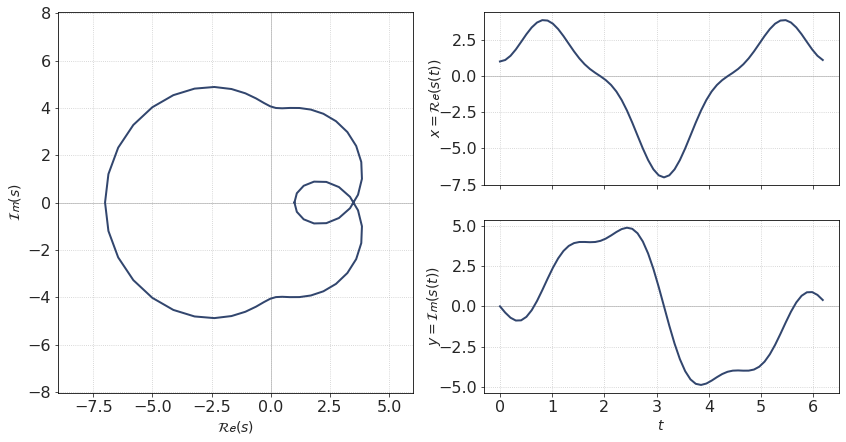

In [7]:
fig = plt.figure(figsize=(14, 7))
ax1 = plt.subplot(1,2,1)
ax2 = plt.subplot(2,2,2)
ax3 = plt.subplot(2,2,4)

ax1.plot(np.append(x, x[0]),np.append(y,y[0]))
ax2.plot(t, x)
ax3.plot(t, y)

ax1.set_xlabel('$\mathcal {Re}(s)$')
ax1.set_ylabel('$\mathcal {Im}(s)$')
ax1.set_aspect(1, adjustable='datalim')
ax1.set_xlim([-9, 6])
ax1.axvline(0, lw = 1, c=[0.8,0.8,0.8],zorder = 0)
ax1.axhline(0, lw = 1, c=[0.8,0.8,0.8],zorder = 0)

ax2.axhline(0, lw = 1, c=[0.8,0.8,0.8],zorder = 0)
ax3.axhline(0, lw = 1, c=[0.8,0.8,0.8],zorder = 0)

ax2.set_ylabel('$x = \mathcal {Re}(s(t))$', labelpad = -5)
ax3.set_ylabel('$y = \mathcal {Im}(s(t))$', labelpad = -5)
ax3.set_xlabel('$t$')
ax2.axes.get_xaxis().set_ticklabels([])

fig.align_labels()
# f.tight_layout()

plt.show()

By the way, we can plot this graph in 3D

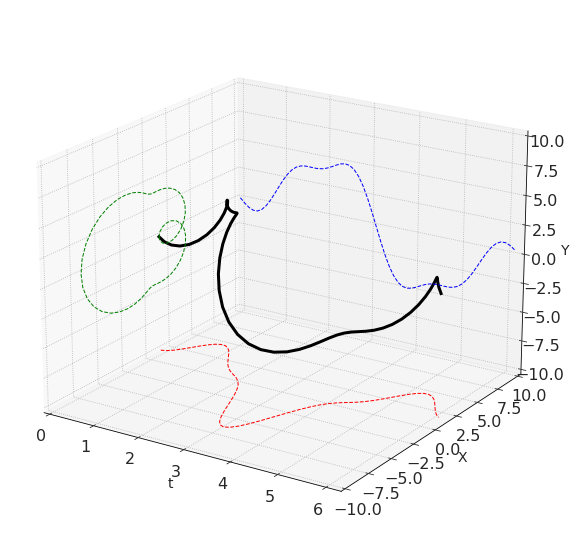

In [8]:
fig = plt.figure(figsize = [10,10])
ax = plt.axes(projection='3d', azim = -57, elev = 20)

ax.plot3D(t, x, y, 'k', lw=3)
ax.plot3D(t, 10+0*x, y, 'b', ls='--', lw = 1)
ax.plot3D(t, x, -10+0*y, 'r', ls='--', lw = 1)
ax.plot3D(0*np.append(t, t[0]), np.append(x, x[0]), np.append(y, y[0]), 'g', ls='--', lw = 1)

ax.set_xlim(0, np.max(t))
ax.set_ylim(-10, 10)
ax.set_zlim(-10, 10)
ax.set_xlabel('t')
ax.set_ylabel('X')
ax.set_zlabel('Y')

plt.show()

Signal spectrum:


In [9]:
from scipy.fftpack import fft, ifft
from scipy.fftpack import fftfreq, fftshift

In [10]:
S = fft(signal)
W = abs(S)
P = angle(S)

fr = fftfreq(len(signal), d = dt)

The values in the result are strangely sorted (due to some technical issues in FFT implementation): first sample is a DC term, followed by $N/2$ positive frequencies, and then we see negative frequencies. *(See [NumPy documentation](https://numpy.org/doc/stable/reference/routines.fft.html#implementation-details) for details)*

The left column in a figure below shows the spectrum in mentioned order (harmonics plotted against their number).

The plots on the right are more intuitive because the spectrum is re-sorted from negative to positive frequencies (harmonics plotted against their frequency in Hz).

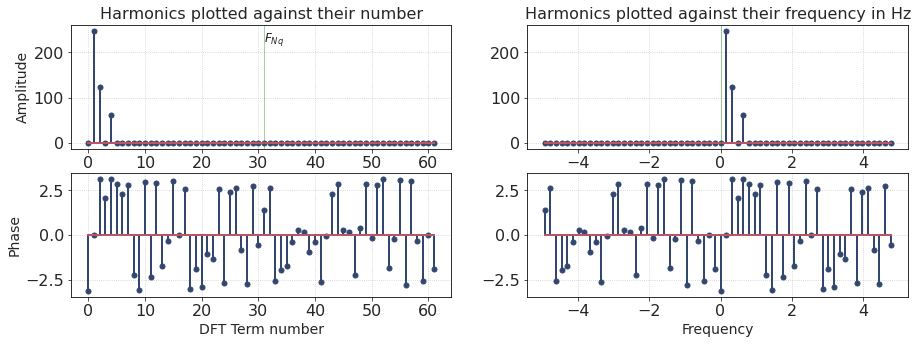

In [11]:
f, ax = plt.subplots(2,2, figsize = [15,5])

ax = ax.ravel()

ax[0].set_title('Harmonics plotted against their number')
ax[0].stem(W)
ax[0].text(len(W)//2, 0.9*np.max(W), '$F_{Nq}$', ha = 'left', fontsize = 12)
ax[0].axvline(len(W)//2, lw = 0.5, c = 'g', alpha = 0.7)
ax[0].set_ylabel('Amplitude')

ax[2].stem(P)
ax[2].set_xlabel('DFT Term number')
ax[2].set_ylabel('Phase')


ax[1].set_title('Harmonics plotted against their frequency in Hz')
ax[1].stem(fr, W)
ax[1].axvline(0, lw = 0.5, c = 'g', alpha = 0.7)

ax[3].stem(fr, P)
ax[3].set_xlabel('Frequency')

plt.show()

The spectrum contains many samples, but only three of them have a non-zero amplitude. Looks like our signal is made up of three harmonics corresponding to positive frequencies.

The frequency of each harmonic depends on its index number. Here we have harmonics 1, 2, 4. Their amplitudes are proportional to {4, 2, 1}, respectively. This, by the way, corresponds to the formula representing our signal.

### Animation

Each harmonic can be related to a line segment rotating with a given frequency. The signal $s(t)$ is formed like a vector-sum of all segments/harmonics.

*Below there are rather bulky cells with animation code. I chose to hide them by default*

In [12]:
%%capture

from matplotlib import animation
from IPython.display import HTML


nframes = len(x)
frame_step = int(len(x)/nframes)
frame_interval = 50


fig = plt.figure(figsize=(14, 7))
ax = plt.subplot(1,2,1)
ax2 = plt.subplot(2,2,2)
ax3 = plt.subplot(2,2,4)


ax.axvline(0, lw = 1, c=[0.8,0.8,0.8])
ax.axhline(0, lw = 1, c=[0.8,0.8,0.8])

ax2.plot(t, x)
ax3.plot(t, y)

ax2.axes.get_xaxis().set_ticklabels([])

ax.set_aspect(1, adjustable='datalim')

ax.plot(np.append(x, x[0]),np.append(y,y[0]))

line, = ax.plot([], [], lw=2)
scatter_pts = ax.scatter([], [], s = 50, c = 'k', zorder = 10)
scatter_x = ax2.scatter([], [], s = 50, c = 'k', zorder = 10)
scatter_y = ax3.scatter([], [], s = 50, c = 'k', zorder = 10)

hcircles = [plt.Circle((0, 0), 0, color='k', fill=False, lw = 0.2) for i in range(len(x))]
for hcircle in hcircles:
    ax.add_patch(hcircle)

ax.set_xlim([-9,6])

ax.set_xlabel('$\mathcal {Re}(s)$')
ax.set_ylabel('$\mathcal {Im}(s)$')

ax2.set_ylabel('$x = \mathcal {Re}(s(t))$', labelpad = -5)
ax3.set_ylabel('y = $\mathcal {Im}(s(t))$', labelpad = -5)
ax3.set_xlabel('$t$')

fig.align_labels()
# fig.tight_layout()

In [13]:
# initialization function: plot the background of each frame
def init():
    line.set_data([], [])
    return (line,)

def animate(i):
    P_i = i/len(x) * 2*pi * np.arange(len(x)) + P
    amp_i = W/len(x)

    x_i = np.zeros_like(W)
    y_i = np.zeros_like(W)

    for j in range(len(S)//2):
        x_i[2*j] = amp_i[j] * cos(P_i[j])
        y_i[2*j] = amp_i[j] * sin(P_i[j])
        x_i[2*j+1] = amp_i[-j-1] * cos(P_i[-j-1])
        y_i[2*j+1] = amp_i[-j-1] * sin(P_i[-j-1])
        
    linepoints_x = np.insert(np.cumsum(x_i), 0,0)
    linepoints_y = np.insert(np.cumsum(y_i), 0,0)
    
    for j in range(1, len(linepoints_x)-1):
        hcircles[j].set_center((linepoints_x[j], linepoints_y[j]))
        hcircles[j].set_radius(np.sqrt(x_i[j]**2 + y_i[j]**2))
  
    line.set_data(linepoints_x,linepoints_y)
        
    scatter_pts.set_offsets((linepoints_x[-1], linepoints_y[-1]))
    scatter_x.set_offsets((t[i], x[i]))
    scatter_y.set_offsets((t[i], y[i]))
    
    return line,



anim = animation.FuncAnimation(fig, animate, init_func=init,
                               frames = nframes, interval = frame_interval, blit=True)
HTML(anim.to_jshtml())

### Observations

1. There are indeed three harmonics (segments) that form this signal
2. Their lenghts are 4, 2 and 1.
3. They are rotating in the same direction (counterclockwise), but at different frequencies

```{image} ./Images/Fourier_anim_01.png
:alt: Rotation direction - positive harmonics
:class: bg-primary mb-1
:align: center
```

## Negative frequencies?

Before we proceed, we need to discuss the meaning of "negative frequencies".

Recall that Fourier spectrum is periodic. It means that negative frequencies are, in fact, the same thing as "ultra-high" frequencies (harmonics with frequency higher than Nyqist frequency). This fact has a cool meaning in terms of rotating lines.

Imagine we have a single rotating line. We are plotting it frame-by frame, and it turns a little bit every frame. But what if it rotates very fast? By *very* I mean that its frequency is higher than Nyqist frequency. In this case it makes more than half a turn every frame.

If frequency is significantly higher than Nyqust frequency, the line will make almost a full circle each frame. And then it will appear as rotating backwards.

Since the frequency spectrum is periodic, this conclusion stays true for 'negative' harmonics.

Thus, negative harmonics can be seen as line segments rotating in the opposite direction.

For example, consider a harmonic marked by a thick blue arrow in the picture below. It can be treated as either negative ($f < 0$) or high-frequency positive ($f > f_{Nq}$) .

```{image} ./Images/Fourier_spectrum_periodicity.png
:alt: Fourier spectrum periodicity
:class: bg-primary mb-1
:width: 700px
:align: center
```

In the picture below, you can see the illustration of this concept.

- In the upper row, a rapidly spinning positive harmonic is depicted. 
- In the lower row, the same line segment is slowly rotating in the opposite direction.

So there is no need to be afraid of negative frequencies. They are just line segments rotating backwards (clock-wise).

```{image} ./Images/Negative_harmonics.png
:alt: Negative harmonics
:class: bg-primary mb-1
:align: center
```

## Example 2. Positive and negative harmonics

The next signal is designed to contain negative harmonics.

In [14]:
dt = pi/25

t = np.arange(0, 2*pi, dt)

x = 4*cos(t) + 3*cos(2*t)
y = 4*sin(t) - 3*sin(2*t)

signal = x + 1j * y

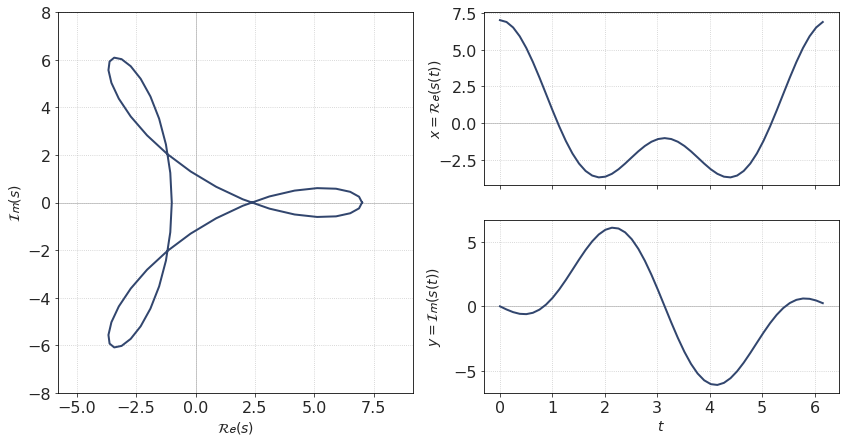

In [15]:
fig = plt.figure(figsize=(14, 7))
ax1 = plt.subplot(1,2,1)
ax2 = plt.subplot(2,2,2)
ax3 = plt.subplot(2,2,4)

ax1.plot(np.append(x, x[0]),np.append(y,y[0]))
ax1.set_aspect(1, adjustable='datalim')

ax1.set_ylim([-8, 8])
ax1.axvline(0, lw = 1, c=[0.8,0.8,0.8],zorder = 0)
ax1.axhline(0, lw = 1, c=[0.8,0.8,0.8],zorder = 0)

ax2.plot(t, x)
ax3.plot(t, y)

ax2.axhline(0, lw = 1, c=[0.8,0.8,0.8],zorder = 0)
ax3.axhline(0, lw = 1, c=[0.8,0.8,0.8],zorder = 0)

ax1.set_xlabel('$\mathcal {Re}(s)$')
ax1.set_ylabel('$\mathcal {Im}(s)$')

ax2.set_ylabel('$x = \mathcal {Re}(s(t))$', labelpad = -5)
ax3.set_ylabel('$y = \mathcal {Im}(s(t))$', labelpad = -5)
ax3.set_xlabel('$t$')
ax2.axes.get_xaxis().set_ticklabels([])

fig.align_labels()
# f.tight_layout()

plt.show()

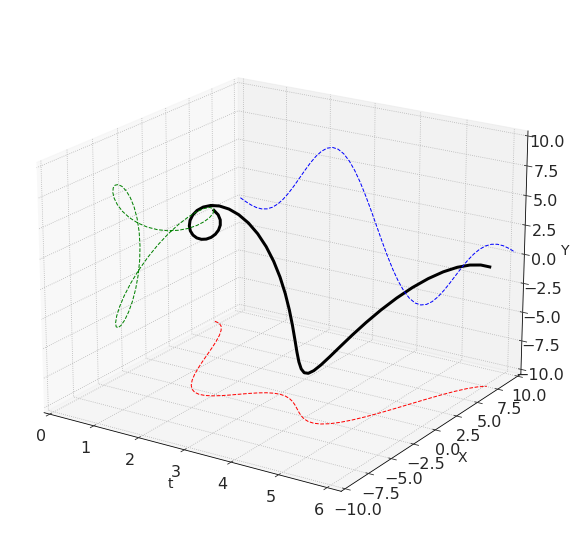

In [16]:
fig = plt.figure(figsize = [10,10])
ax = plt.axes(projection='3d', azim = -57, elev = 20)

ax.plot3D(t, x, y, 'k', lw=3)
ax.plot3D(t, 10+0*x, y, 'b', ls='--', lw = 1)
ax.plot3D(t, x, -10+0*y, 'r', ls='--', lw = 1)
ax.plot3D(0*np.append(t, t[0]), np.append(x, x[0]), np.append(y, y[0]), 'g', ls='--', lw = 1)

ax.set_xlim(0, np.max(t))
ax.set_ylim(-10, 10)
ax.set_zlim(-10, 10)
ax.set_xlabel('t')
ax.set_ylabel('X')
ax.set_zlabel('Y')

plt.show()

The spectrum of this signal:

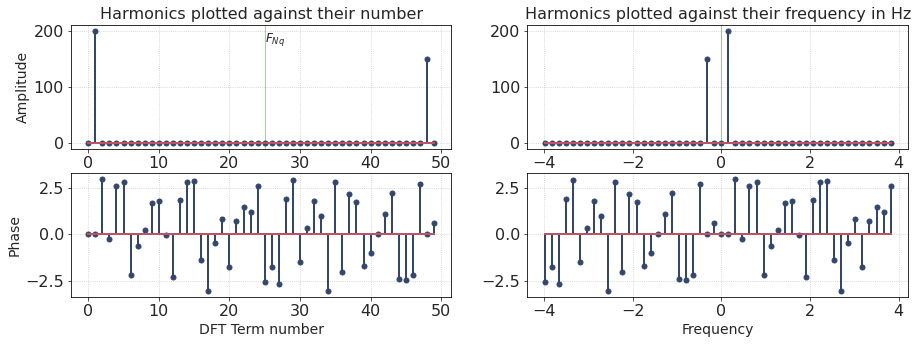

In [17]:
S = fft(signal)
W = abs(S)
P = angle(S)

fr = fftfreq(len(signal), d = dt)

f, ax = plt.subplots(2,2, figsize = [15,5])

ax = ax.ravel()

ax[0].stem(W)
ax[0].text(len(W)//2, 0.9*np.max(W), '$F_{Nq}$', ha = 'left', fontsize = 12)
ax[0].axvline(len(W)//2, lw = 0.5, c = 'g', alpha = 0.7)
ax[0].set_ylabel('Amplitude')

ax[0].set_title('Harmonics plotted against their number')

ax[2].stem(P)
ax[2].set_xlabel('DFT Term number')
ax[2].set_ylabel('Phase')

ax[1].stem(fr, W)
ax[1].axvline(0, lw = 0.5, c = 'g', alpha = 0.7)
ax[1].set_title('Harmonics plotted against their frequency in Hz')

ax[3].stem(fr, P)
ax[3].set_xlabel('Frequency')

plt.show()

This signal is formed by two harmonics only:
1. Index = 1, Amplitude: 4
2. Index = -2, Amplitude: 3


### Animation

In [18]:
nframes = len(x)
frame_step = int(len(x)/nframes)
frame_interval = 50

In [19]:
%%capture

fig = plt.figure(figsize=(14, 7))
ax = plt.subplot(1,2,1)
ax2 = plt.subplot(2,2,2)
ax3 = plt.subplot(2,2,4)


ax.axvline(0, lw = 1, c=[0.8,0.8,0.8])
ax.axhline(0, lw = 1, c=[0.8,0.8,0.8])

ax2.plot(t, x)
ax3.plot(t, y)

ax2.axes.get_xaxis().set_ticklabels([])


ax.set_aspect(1, adjustable='datalim')
ax.plot(np.append(x, x[0]),np.append(y,y[0]))

line, = ax.plot([], [], lw=2)
scatter_pts = ax.scatter([], [], s = 50, c = 'k', zorder = 10)
scatter_x = ax2.scatter([], [], s = 50, c = 'k', zorder = 10)
scatter_y = ax3.scatter([], [], s = 50, c = 'k', zorder = 10)

hcircles = [plt.Circle((0, 0), 0, color='k', fill=False, lw = 0.2) for i in range(len(x))]
for hcircle in hcircles:
    ax.add_patch(hcircle)

    
ax.set_ylim([-8, 8])
ax.set_xlim([-8, 10])


ax.set_xlabel('$\mathcal {Re}(s)$')
ax.set_ylabel('$\mathcal {Im}(s)$')

ax2.set_ylabel('$x = \mathcal {Re}(s(t))$', labelpad = -5)
ax3.set_ylabel('$y = \mathcal {Im}(s(t))$', labelpad = -5)
ax3.set_xlabel('$t$')

fig.align_labels()
# f.tight_layout()


In [20]:
# initialization function: plot the background of each frame
def init():
    line.set_data([], [])
    
    return (line,)

def animate(i):
    P_i = i/len(x) * 2*pi * np.arange(len(x)) + P
    amp_i = W/len(x)

    x_i = np.zeros_like(W)
    y_i = np.zeros_like(W)

    for j in range(len(S)//2):
        x_i[2*j] = amp_i[j] * cos(P_i[j])
        y_i[2*j] = amp_i[j] * sin(P_i[j])
        x_i[2*j+1] = amp_i[-j-1] * cos(P_i[-j-1])
        y_i[2*j+1] = amp_i[-j-1] * sin(P_i[-j-1])
        
    linepoints_x = np.insert(np.cumsum(x_i), 0,0)
    linepoints_y = np.insert(np.cumsum(y_i), 0,0)
    
    for j in range(1, len(linepoints_x)-1):
        hcircles[j].set_center((linepoints_x[j], linepoints_y[j]))
        hcircles[j].set_radius(np.sqrt(x_i[j]**2 + y_i[j]**2))
        
  
    line.set_data(linepoints_x,linepoints_y)
        
    scatter_pts.set_offsets((linepoints_x[-1], linepoints_y[-1]))
    scatter_x.set_offsets((t[i], x[i]))
    scatter_y.set_offsets((t[i], y[i]))
    
    return line,

anim = animation.FuncAnimation(fig, animate, init_func=init,
                               frames = nframes, interval = frame_interval, blit=True)
HTML(anim.to_jshtml())



We see two line segments rotating in opposite directions with different frequencies.

While the first one (index = 1, amplitude = 4) makes a full circle, the other one (index = -2, amplitude = 3) makes two turns.

```{image} ./Images/Fourier_anim_02_negative.png
:alt: Rotation direction - negative harmonics
:class: bg-primary mb-1
:align: center
```


## Example 3. Many harmonics

In [21]:
dt = pi/75

t = np.arange(0, 2*pi, dt)

r = 1.2 + 0.5*cos(2*t+0.2) + 1*sin(4*t+0) + 1*sin(6*t - 1.75) + 0.3*sin(t)

x = r*cos(t)
y = r*sin(t)

signal = x + 1j * y

This signal is slightly more complicated. Its equation is written in polar coordinates. Its spectrum contains several positive and negative harmonics.

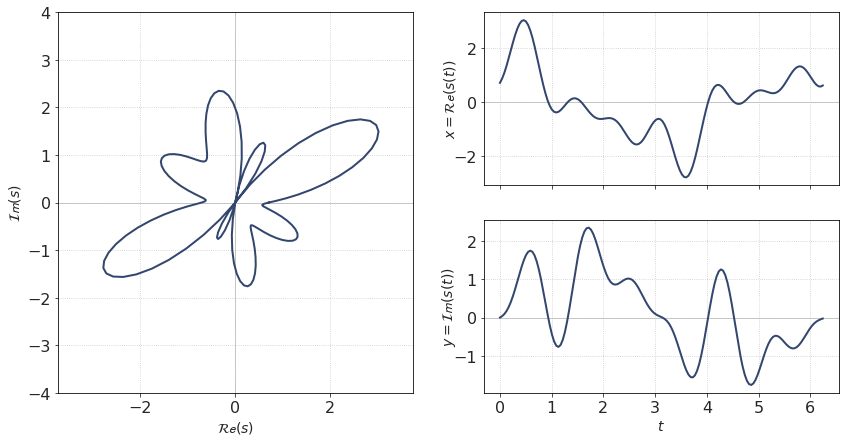

In [22]:
fig = plt.figure(figsize=(14, 7))
ax1 = plt.subplot(1,2,1)
ax2 = plt.subplot(2,2,2)
ax3 = plt.subplot(2,2,4)

ax1.plot(np.append(x, x[0]),np.append(y,y[0]))
ax1.set_aspect(1, adjustable='datalim')

ax1.set_ylim([-4, 4])
ax1.set_xlim([-4, 4])
ax1.axvline(0, lw = 1, c=[0.8,0.8,0.8],zorder = 0)
ax1.axhline(0, lw = 1, c=[0.8,0.8,0.8],zorder = 0)

ax2.plot(t, x)
ax3.plot(t, y)

ax2.axhline(0, lw = 1, c=[0.8,0.8,0.8],zorder = 0)
ax3.axhline(0, lw = 1, c=[0.8,0.8,0.8],zorder = 0)

ax1.set_xlabel('$\mathcal {Re}(s)$')
ax1.set_ylabel('$\mathcal {Im}(s)$')

ax2.set_ylabel('$x = \mathcal {Re}(s(t))$', labelpad = -5)
ax3.set_ylabel('$y = \mathcal {Im}(s(t))$', labelpad = -5)
ax3.set_xlabel('$t$')
ax2.axes.get_xaxis().set_ticklabels([])

fig.align_labels()
# f.tight_layout()

plt.show()

Spectrum:

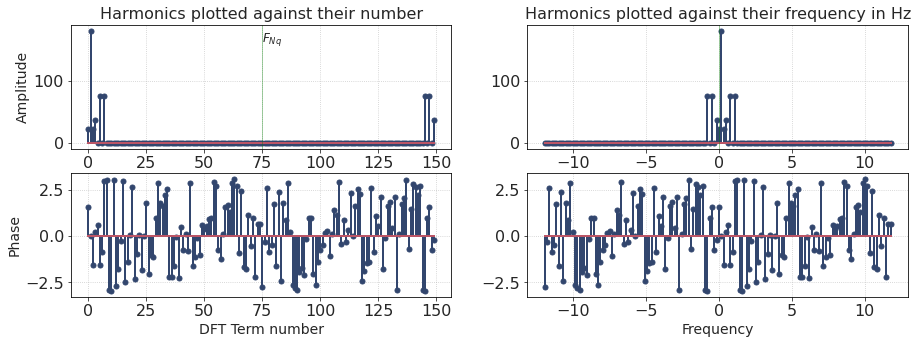

In [23]:
S = fft(signal)
W = abs(S)
P = angle(S)

fr = fftfreq(len(signal), d = dt)

f, ax = plt.subplots(2,2, figsize = [15,5])

ax = ax.ravel()

ax[0].stem(W)
ax[0].text(len(W)//2, 0.9*np.max(W), '$F_{Nq}$', ha = 'left', fontsize = 12)
ax[0].axvline(len(W)//2, lw = 0.5, c = 'g', alpha = 0.7)
ax[0].set_ylabel('Amplitude')

ax[0].set_title('Harmonics plotted against their number')

ax[2].stem(P)
ax[2].set_xlabel('DFT Term number')
ax[2].set_ylabel('Phase')

ax[1].stem(fr, W)
ax[1].axvline(0, lw = 0.5, c = 'g', alpha = 0.7)
ax[1].set_title('Harmonics plotted against their frequency in Hz')

ax[3].stem(fr, P)
ax[3].set_xlabel('Frequency')

plt.show()

### Animation


In [24]:
nframes = len(x)
frame_step = int(len(x)/nframes)
frame_interval = 50

In [25]:
%%capture

fig = plt.figure(figsize=(14, 7))
ax = plt.subplot(1,2,1)
ax2 = plt.subplot(2,2,2)
ax3 = plt.subplot(2,2,4)


ax.axvline(0, lw = 1, c=[0.8,0.8,0.8])
ax.axhline(0, lw = 1, c=[0.8,0.8,0.8])

ax2.plot(t, x)
ax3.plot(t, y)

ax2.axes.get_xaxis().set_ticklabels([])

ax.set_aspect(1, adjustable='datalim')
ax.plot(np.append(x, x[0]),np.append(y,y[0]))

line, = ax.plot([], [], lw=2)
scatter_pts = ax.scatter([], [], s = 50, c = 'k', zorder = 10)
scatter_x = ax2.scatter([], [], s = 50, c = 'k', zorder = 10)
scatter_y = ax3.scatter([], [], s = 50, c = 'k', zorder = 10)

hcircles = [plt.Circle((0, 0), 0, color='k', fill=False, lw = 0.2) for i in range(len(x))]
for hcircle in hcircles:
    ax.add_patch(hcircle)

ax.set_ylim([-4, 4])
ax.set_xlim([-4, 4])

ax.set_xlabel('$\mathcal {Re}(s)$')
ax.set_ylabel('$\mathcal {Im}(s)$')

ax2.set_ylabel('$x = \mathcal {Re}(s(t))$', labelpad = -5)
ax3.set_ylabel('$y = \mathcal {Im}(s(t))$', labelpad = -5)
ax3.set_xlabel('$t$')

fig.align_labels()
# f.tight_layout()


In [26]:
# initialization function: plot the background of each frame
def init():
    line.set_data([], [])
    
    return (line,)

def animate(i):
    P_i = i/len(x) * 2*pi * np.arange(len(x)) + P
    amp_i = W/len(x)

    x_i = np.zeros_like(W)
    y_i = np.zeros_like(W)

    for j in range(len(S)//2):
        x_i[2*j] = amp_i[j] * cos(P_i[j])
        y_i[2*j] = amp_i[j] * sin(P_i[j])
        x_i[2*j+1] = amp_i[-j-1] * cos(P_i[-j-1])
        y_i[2*j+1] = amp_i[-j-1] * sin(P_i[-j-1])
        
    linepoints_x = np.insert(np.cumsum(x_i), 0,0)
    linepoints_y = np.insert(np.cumsum(y_i), 0,0)
    
    for j in range(1, len(linepoints_x)-1):
        hcircles[j].set_center((linepoints_x[j], linepoints_y[j]))
        hcircles[j].set_radius(np.sqrt(x_i[j]**2 + y_i[j]**2))
        
  
    line.set_data(linepoints_x,linepoints_y)
        
    scatter_pts.set_offsets((linepoints_x[-1], linepoints_y[-1]))
    scatter_x.set_offsets((t[i], x[i]))
    scatter_y.set_offsets((t[i], y[i]))

    return line,

anim = animation.FuncAnimation(fig, animate, init_func=init,
                               frames = nframes, interval = frame_interval, blit=True)
HTML(anim.to_jshtml())



## Example 4. Real-valued signal

What is a *real* signal? This is a signal that has no imaginary part, i.e. coordinate $𝑌$ equals to zero.

In terms of Fourier harmonics, it means that the segments must rotate in such a way that the endpoint moves strictly along the X-axis.

The Fourier spectrum of a real signal is known to be symmetrical (complex conjugate) with respect to the Nyquist frequency. The amplitude spectrum is even, but the phase spectrum is odd. In terms of the rotating segments discussed above, this means that a real signal is formed by segments of equal length, rotating in opposite directions.

Let's make a [Ricker wavelet](ricker-wavelet-page) and show its harmonics.

In [27]:
dt = 0.002

t = np.arange(0, 0.1, dt)
central_freq = 20
t_sh = t - 0.5*np.max(t)

x = (1 - 2*pi*pi*central_freq*central_freq*t_sh*t_sh)*np.exp(-pi*pi*central_freq*central_freq*t_sh*t_sh)

y = np.zeros_like(t)

signal = x + 1j*y

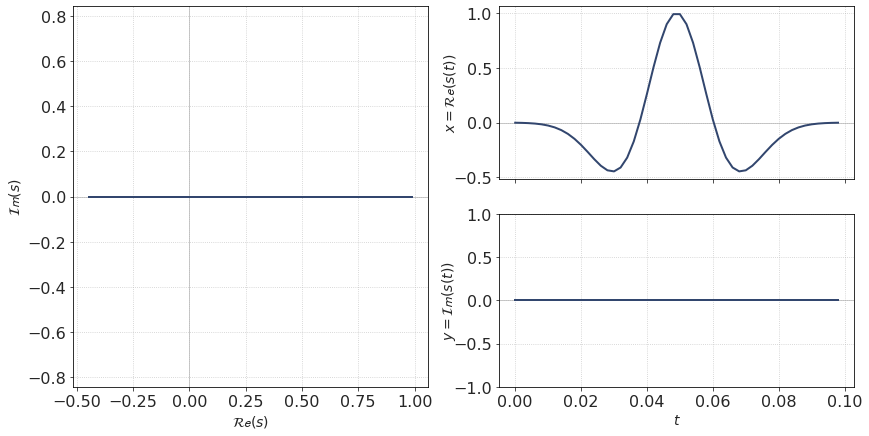

In [28]:
fig = plt.figure(figsize=(14, 7))
ax1 = plt.subplot(1,2,1)
ax2 = plt.subplot(2,2,2)
ax3 = plt.subplot(2,2,4)

ax1.plot(np.append(x, x[0]),np.append(y,y[0]))
ax1.set_aspect(1, adjustable='datalim')

ax1.set_ylim([-1.2, 1.2])

ax1.axvline(0, lw = 1, c=[0.8,0.8,0.8],zorder = 0)
ax1.axhline(0, lw = 1, c=[0.8,0.8,0.8],zorder = 0)

ax2.plot(t, x)
ax3.plot(t, y)

ax2.axhline(0, lw = 1, c=[0.8,0.8,0.8],zorder = 0)
ax3.axhline(0, lw = 1, c=[0.8,0.8,0.8],zorder = 0)

ax1.set_xlabel('$\mathcal {Re}(s)$')
ax1.set_ylabel('$\mathcal {Im}(s)$')

ax2.set_ylabel('$x = \mathcal {Re}(s(t))$', labelpad = -5)
ax3.set_ylabel('$y = \mathcal {Im}(s(t))$', labelpad = -5)
ax3.set_xlabel('$t$')
ax3.set_ylim([-1,1])
ax2.axes.get_xaxis().set_ticklabels([])

fig.align_labels()
# f.tight_layout()

plt.show()

As expected, this signal has only the real part.

Spectrum:

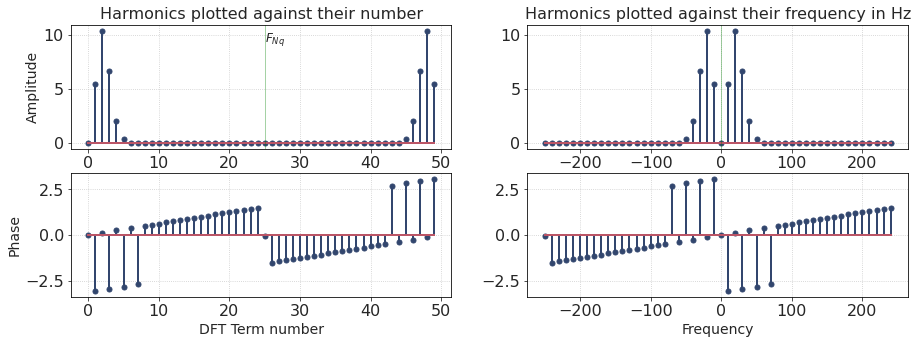

In [29]:
S = fft(signal)
W = abs(S)
P = angle(S)

fr = fftfreq(len(signal), d = dt)

f, ax = plt.subplots(2,2, figsize = [15,5])

ax = ax.ravel()

ax[0].stem(W)
ax[0].text(len(W)//2, 0.9*np.max(W), '$F_{Nq}$', ha = 'left', fontsize = 12)
ax[0].axvline(len(W)//2, lw = 0.5, c = 'g', alpha = 0.7)
ax[0].set_ylabel('Amplitude')

ax[0].set_title('Harmonics plotted against their number')

ax[2].stem(P)
ax[2].set_xlabel('DFT Term number')
ax[2].set_ylabel('Phase')

ax[1].stem(fr, W)
ax[1].axvline(0, lw = 0.5, c = 'g', alpha = 0.7)
ax[1].set_title('Harmonics plotted against their frequency in Hz')

ax[3].stem(fr, P)
ax[3].set_xlabel('Frequency')

plt.show()

1. The spectrum is symmetrical
2. The spectrum is not zero-phase because the wavelet is, in fact, shifted by half of samples (we discussed it in the [Ricker wavelet page](ricker-wavelet-zero-phase))

### Animation


In [30]:
nframes = len(x)
frame_step = int(len(x)/nframes)
frame_interval = 50

In [31]:
%%capture

fig = plt.figure(figsize=(14, 7))
ax = plt.subplot(1,2,1)
ax2 = plt.subplot(2,2,2)
ax3 = plt.subplot(2,2,4)


ax.axvline(0, lw = 1, c=[0.8,0.8,0.8])
ax.axhline(0, lw = 1, c=[0.8,0.8,0.8])


ax2.plot(t, x)
ax3.plot(t, y)

ax2.axes.get_xaxis().set_ticklabels([])

ax.set_aspect(1, adjustable='datalim')
ax.plot(np.append(x, x[0]),np.append(y,y[0]))

line, = ax.plot([], [], lw=2)
scatter_pts = ax.scatter([], [], s = 50, c = 'k', zorder = 10)
scatter_x = ax2.scatter([], [], s = 50, c = 'k', zorder = 10)
scatter_y = ax3.scatter([], [], s = 50, c = 'k', zorder = 10)

hcircles = [plt.Circle((0, 0), 0, color='k', fill=False, lw = 0.2) for i in range(len(x))]
for hcircle in hcircles:
    ax.add_patch(hcircle)

ax.set_ylim([-1.2, 1.2])

ax.set_xlabel('$\mathcal {Re}(s)$')
ax.set_ylabel('$\mathcal {Im}(s)$')

ax2.set_ylabel('$x = \mathcal {Re}(s(t))$', labelpad = -5)
ax3.set_ylabel('$y = \mathcal {Im}(s(t))$', labelpad = -5)
ax3.set_xlabel('$t$')
ax3.set_ylim([-1,1])

fig.align_labels()
# f.tight_layout()


In [32]:
# initialization function: plot the background of each frame
def init():
    line.set_data([], [])
    
    return (line,)

def animate(i):
    P_i = i/len(x) * 2*pi * np.arange(len(x)) + P
    amp_i = W/len(x)

    x_i = np.zeros_like(W)
    y_i = np.zeros_like(W)

    for j in range(len(S)//2):
        x_i[2*j] = amp_i[j] * cos(P_i[j])
        y_i[2*j] = amp_i[j] * sin(P_i[j])
        x_i[2*j+1] = amp_i[-j-1] * cos(P_i[-j-1])
        y_i[2*j+1] = amp_i[-j-1] * sin(P_i[-j-1])
        
    linepoints_x = np.insert(np.cumsum(x_i), 0,0)
    linepoints_y = np.insert(np.cumsum(y_i), 0,0)
    
    for j in range(1, len(linepoints_x)-1):
        hcircles[j].set_center((linepoints_x[j], linepoints_y[j]))
        hcircles[j].set_radius(np.sqrt(x_i[j]**2 + y_i[j]**2))
        
  
    line.set_data(linepoints_x,linepoints_y)
        
    scatter_pts.set_offsets((linepoints_x[-1], linepoints_y[-1]))
    scatter_x.set_offsets((t[i], x[i]))
    scatter_y.set_offsets((t[i], y[i]))

    return line,

anim = animation.FuncAnimation(fig, animate, init_func=init,
                               frames = nframes, interval = frame_interval, blit=True)
HTML(anim.to_jshtml())



As we can see, this signal is made up by 5 positive and 5 negative harmonics that synchronously rotate in opposite directions. This is why the endpoint can move along the horizontal line *y = 0*.


## Conclusions

1. Complex signals can be interpreted as lines on a 2D Cartesian plane. Real signals have no imaginary part, so they correspond to lines aligned with X-axis
2. Fourier spectrum contains positive and negative harmonics. Due to periodicity, negative harmonics can be interpreted as positive with frequency higher than Nyqist frequency.
3. Each harmonic can be visualized as a rotating line segment. Since the signal is the sum of all harmonics, its plot in 2D can be drawn by the endpoint of 'connected' spinning lines.
4. Positive harmonics rotate CCW, negative ones rotate CW. But remember that the negative harmonics are identical to high-frequency positive harmonics.
5. Real signals have to stay within $y = 0$ plane, so positive and negative harmonics have to be balanced and compensate each other. That's why Fourier spectrum of a real signal is symmetrical with respect to zero. Positive and negatice harmonics have equal amplitudes and opposite phases.




___
<sub>Modified: Sep 12, 2022</sub>